In [1]:
# Most Code here
import sys
#Switch to deepliver
#if "/opt/caffe/python" in sys.path : sys.path.remove("/opt/caffe/python")
#if "/opt/deepliver/python" not in sys.path : sys.path.insert(0,"/opt/deepliver/python")

import plyvel, lutils, math, re
from collections import defaultdict
import numpy as np
from matplotlib import pyplot as plt
from IPython import display
import pandas
from PIL import Image,ImageFilter
plt.set_cmap('gray')
%matplotlib inline

def hist(arr):
    """Print number of pixels for each label in the given image (arr)"""
    return "%.3f , %.3f , %.3f, %.3f" % (np.sum(arr==0),np.sum(arr==1),np.sum(arr==2),np.sum(arr==4))

def imshow(*args,**kwargs):
    """ Handy function to show multiple plots in on row, possibly with different cmaps
    Usage: 
    imshow(img1, title="myPlot")
    imshow(img1,img2)
    imshow(img1,img2, cmap='hot')
    imshow(img1,img2,cmap=['gray','Blues']) """
    cmap = kwargs.get('cmap', 'gray')
    title= kwargs.get('title','')
    if len(args)==0:
        raise ValueError("No images given to imshow")
    elif len(args)==1:
        plt.title(title)
        plt.imshow(args[0], interpolation='none')
    else:
        n=len(args)
        if type(cmap)==str:
            cmap = [cmap]*n
        if type(title)==str:
            title= [title]*n
        plt.figure(figsize=(n*5,10))
        for i in range(n):
            plt.subplot(1,n,i+1)
            plt.title(title[i])
            plt.imshow(args[i], cmap[i])
    plt.show()
        
def dice(prediction, segmentation, label_of_interest = 1):
    """ Takes 2 2-D arrays with class labels, and return a float dice score.
    Only label=label_of_interest is considered """
    if prediction.shape != segmentation.shape:
        raise ValueError("Shape mismatch between given arrays. prediction %s vs segmentation %s" \
                         % (str(prediction.shape), str(segmentation.shape)))

    n_liver_seg = np.sum(segmentation==label_of_interest)
    n_liver_pred= np.sum(prediction == label_of_interest)
    denominator = n_liver_pred + n_liver_seg
    if denominator == 0:
        return -1

    liver_intersection   = np.logical_and(prediction==label_of_interest, segmentation==label_of_interest)
    n_liver_intersection = np.sum(liver_intersection)

    dice_score = 2.0*n_liver_intersection / denominator
    return dice_score

def protobinary_to_array(filename, outpng=None):
    """ Filename is path to protobinary
    outpng is path to output png"""
    with open(filename,'r') as f:
        data = f.read()

    blob = caffe.proto.caffe_pb2.BlobProto()
    blob.ParseFromString(data)
    arr = np.array(caffe.io.blobproto_to_array(blob)) #returns shape (1,1,W,H)
    arr = arr[0,0,:,:] #ignore first 2 dimensions
    return  arr

dices_liver = []
dices_lesion= []
def predict(net, img, seg, meanimg):
    """Predicts an img using the trained net, and compares it to the label image (seg)"""
    net.blobs['data'].data[0]=(img-meanimg)
    prob=net.forward()['prob'][0]
    prediction = np.argmax(prob,axis=0)
    dice_liver = dice(prediction,seg,label_of_interest=1)
    dice_lesion = dice(prediction,seg,label_of_interest=2)
    dices_liver.append(dice_liver)
    dices_lesion.append(dice_lesion)
    print "Dice Liver:", dice_liver
    print "Dice Lesion:",dice_lesion
    print "Prediction class histogram",hist(prediction)
    print "Ground truth class histogram",hist(seg)
    plt.figure(figsize=(20,24))
    plt.subplot(1,3,1); plt.title("Image")
    plt.imshow(img)
    plt.subplot(1,3,2); plt.title("Ground truth")
    plt.imshow(seg)
    plt.subplot(1,3,3); plt.title("Prediction")
    plt.imshow(prediction)
    plt.show()
    
def read_imgs(dbimgit, dbsegit, n=1, print_keys=True):
    """Read img and label after skipping n keys in leveldb. Takes db iterators"""
    for _ in range(n):
        k1,vimg = dbimgit.next()
        k2,vseg = dbsegit.next()
    if print_keys:
        print "Keys:",k1,k2
    img=lutils.to_numpy_matrix(vimg)
    seg=lutils.to_numpy_matrix(vseg)
    return img,seg

def show_kernels(layer_blob_data, fast = False):
    """ Takes solver.net.params['conv1'][0].data and visualize the first channel of all kernels.
    If fast = False : subplots will be used, allowing to see each filter individually, but takes time.
    If fast = True : all filters are plotted in one image"""
    #Input has 4 dims, we only visualize 1st channel of each kernel 
    # (the conv weights that acts on the 1st channel of the input)
    data = layer_blob_data[:,0,:,:]
    if fast:
        raise NotImplementedError("todo")
    n_kernels = data.shape[0]
    plot_cols = 10 #number of images in one row
    plot_rows = math.ceil(n_kernels*1.0 / plot_cols)
    # Adjust figure plot size
    plt.figure(figsize=(min(plot_cols, n_kernels)*2, plot_rows*2))
    # Plot !
    for i in range(n_kernels):
        plt.subplot(plot_rows, plot_cols, i+1)
        plt.imshow(data[i], interpolation='none')
        
def plot_deepliver_log(fname):
    """Takes file handle of deepliver log, and plots the 4 plots :
    Loss, avgAccuracy, avgJaccard, avgRecall"""
    f = open(fname, 'r')
    logs = f.read()
    plt.figure(figsize=(10,10))
    # Get iterations
    iterations = re.findall("Iteration (\d+), loss",logs)

    # Get&plot loss
    loss = zip(*re.findall("Iteration \d+, loss = ([+-]?(\d+(\.\d*)?|\.\d+)([eE][+-]?\d+)?)",logs))[0]
    length = min(len(iterations), len(loss))
    iterations_trunc, loss_trunc = iterations[:length], loss[:length]
    plt.plot(iterations,loss,label='Loss')
    #plt.show()
    #Get&plot metrics
    metrics = ['Accuracy','Recall','Jaccard']
    data = defaultdict(list) # data.keys() = metrics , data[metrics[0]] = list of values
    for i,metric in enumerate(metrics):
        regex = "Train net output #"+str(i)+": accuracy = ([+-]?(\d+(\.\d*)?|\.\d+)([eE][+-]?\d+)?)"
        for result in re.findall(regex,logs):
            data[metric].append(result[0])

    for metric in data.keys():
        length = min(len(iterations),len(data[metric]))
        iterations_trunc, data_trunc = iterations[:length], data[metric][:length]
        plt.plot(iterations_trunc, data_trunc,label=metric)
        plt.legend(loc="lower center",prop={'size':15})
    f.close()


def histeq(im,nbr_bins=256):
    """Histogram equalization"""
    #get image histogram
    imhist,bins = np.histogram(im.flatten(),nbr_bins,normed=True)
    cdf = imhist.cumsum() #cumulative distribution function
    cdf = 255 * cdf / cdf[-1] #normalize
    #use linear interpolation of cdf to find new pixel values
    im2 = np.interp(im.flatten(),bins[:-1],cdf)
    return im2.reshape(im.shape)

def imshow_overlay_segmentation(himg=None,img=None,seg=None,pred=None):
    plt.figure(figsize=(20,10))
    if himg is not None:
        plt.subplot(1,3,1)
        plt.title("Image")
        plt.imshow(himg)
    elif img is not None:
        plt.subplot(1,3,1)
        plt.title("Image")
        plt.imshow(img) 
    
    if seg is not None:
        plt.subplot(1,3,2)
        plt.title("Ground Truth")
        plt.imshow(img); plt.hold(True)
        plt.imshow(seg, cmap="Blues", alpha=0.3)
    
    if pred is not None:
        plt.subplot(1,3,3)
        plt.title("Prediction")
        plt.imshow(img); plt.hold(True)
        plt.imshow(pred, cmap="Reds", alpha=0.3)
        plt.show()

In [2]:
import caffe
print caffe.__file__
caffe.set_mode_gpu()

/opt/caffe/python/caffe/__init__.pyc


## Load Nifti directly ##

In [107]:
import nibabel 
from PIL import Image
import PIL
nifti=nibabel.load("Patient01Homo.nii")
d=nifti.get_data()

# Load the corresponding Label#

In [108]:
labeld=nibabel.load("Patient01Homo_Rad02.nii").get_data()

In [4]:
net1=caffe.Net("florian-unet-deploy.prototxt","florian-unet.caffemodel",caffe.TEST)
net2=caffe.Net("unet-overfit-deploy.prototxt","snapshot/_iter_200000.caffemodel",caffe.TEST)

# Now try 'plain' UNET to get Liver and Lesion #
# Liver: Red , Lesion:Blue#

(177, 177, 98)
(388, 388)


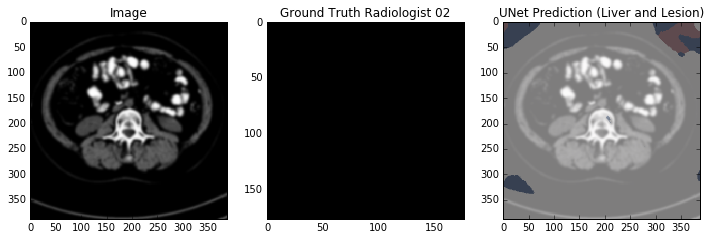

(388, 388)


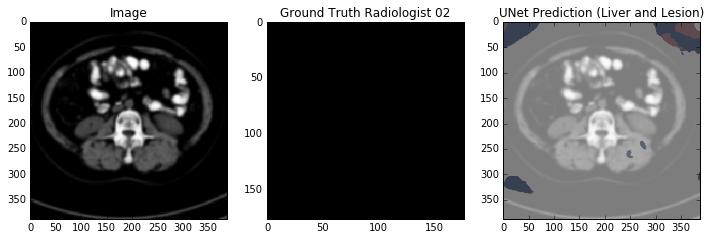

(388, 388)


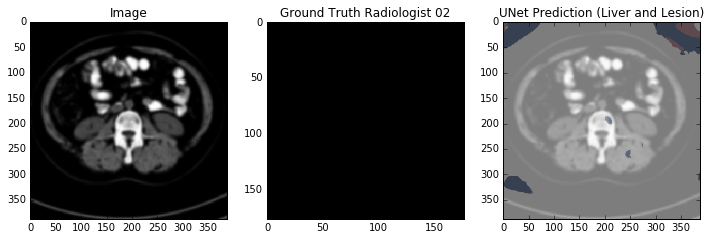

(388, 388)


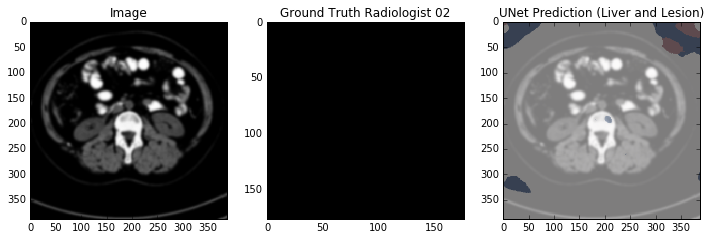

(388, 388)


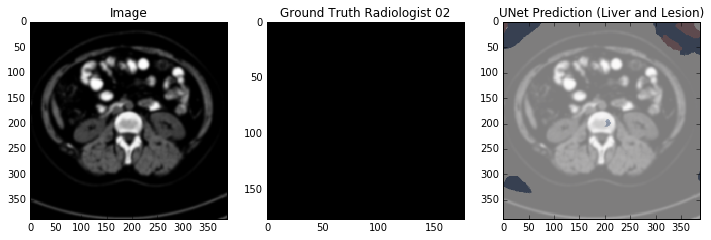

(388, 388)


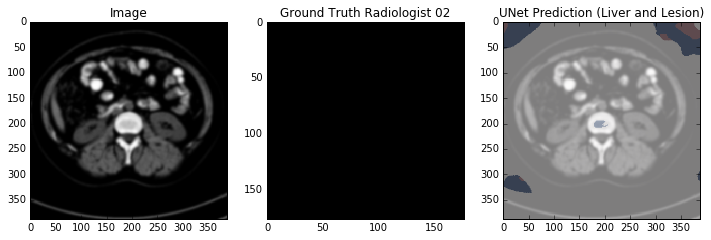

(388, 388)


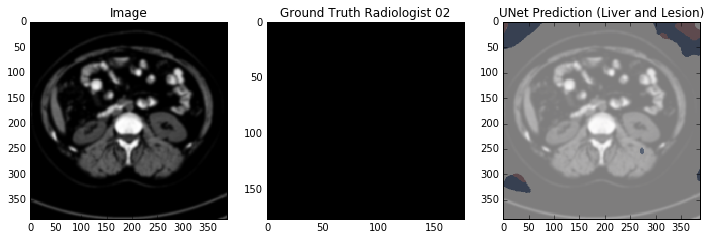

(388, 388)


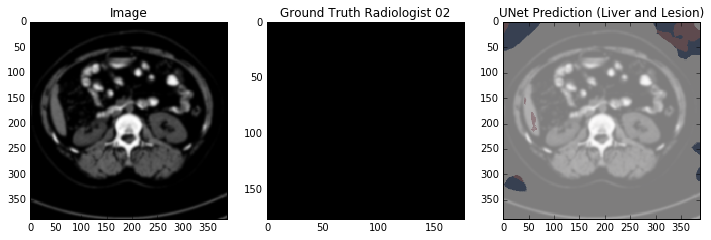

(388, 388)


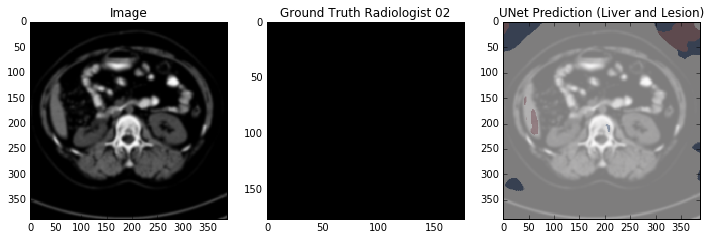

(388, 388)


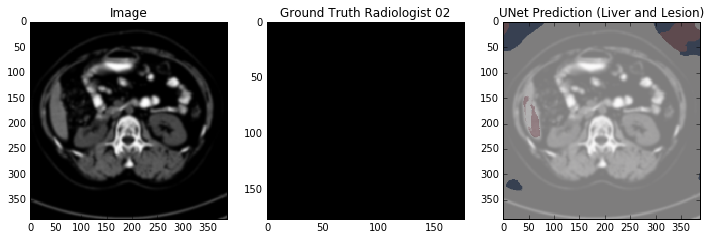

(388, 388)


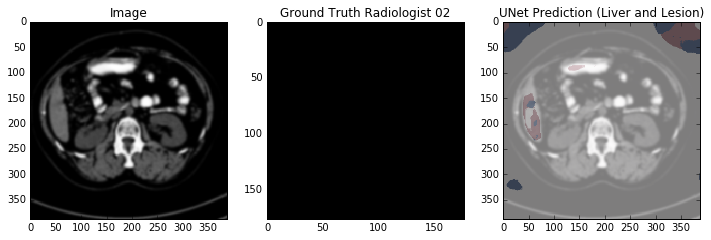

(388, 388)


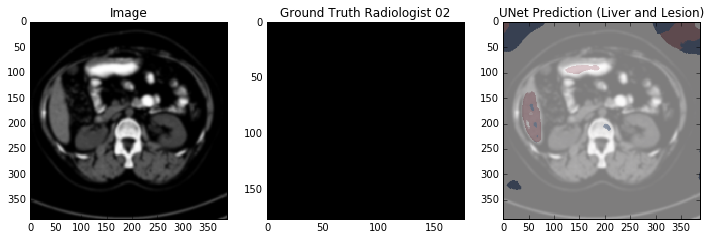

(388, 388)


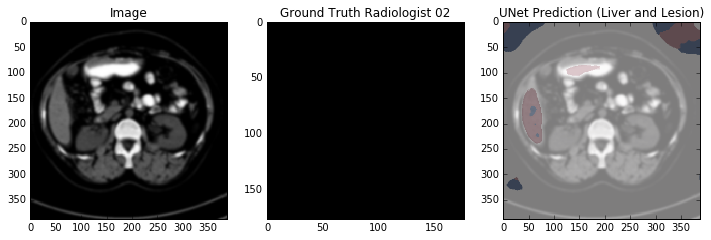

(388, 388)


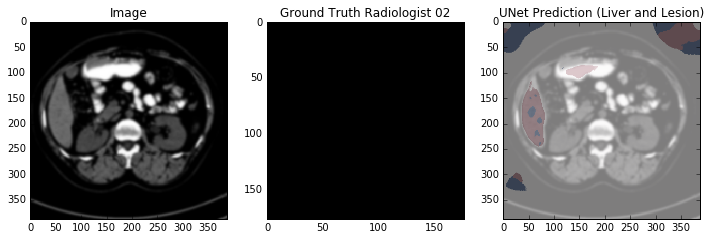

(388, 388)


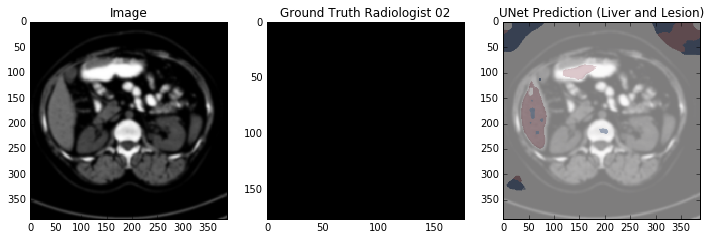

(388, 388)


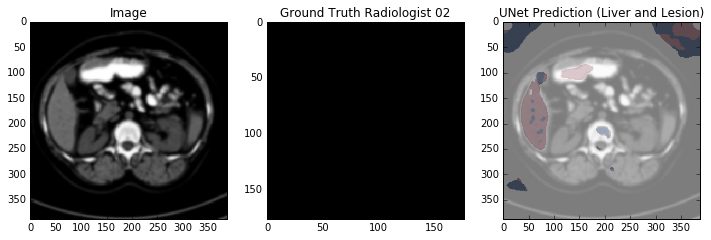

(388, 388)


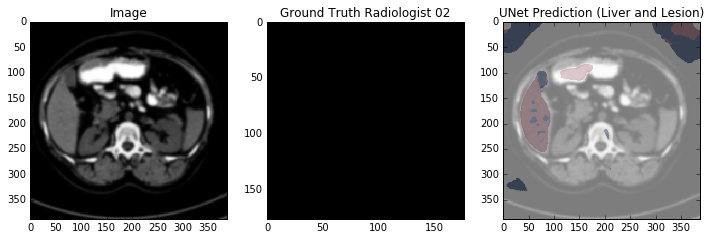

(388, 388)


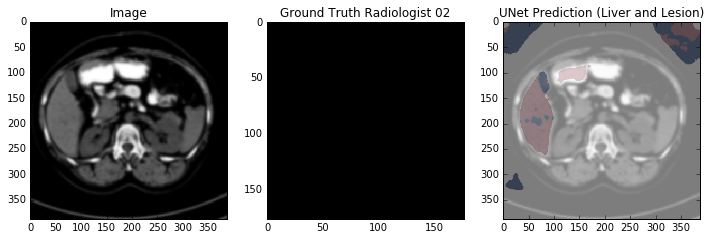

(388, 388)


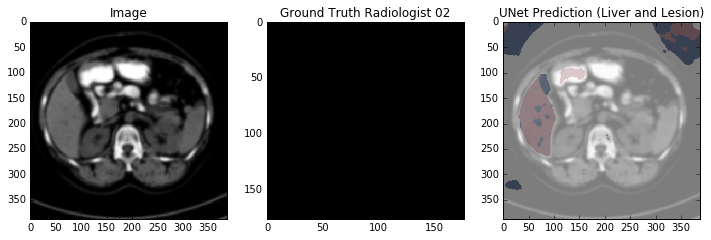

(388, 388)


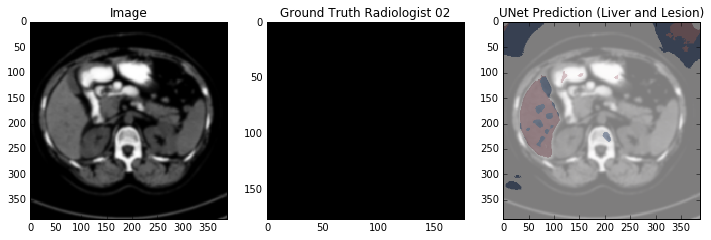

(388, 388)


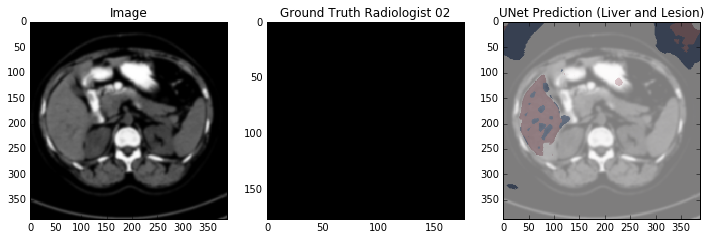

(388, 388)


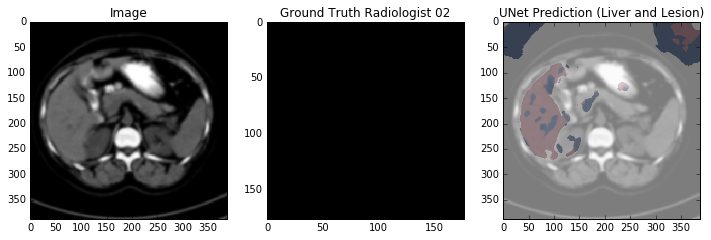

(388, 388)


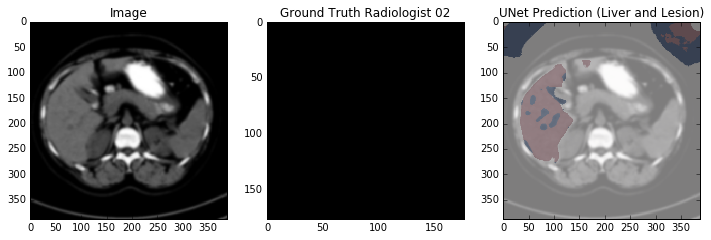

(388, 388)


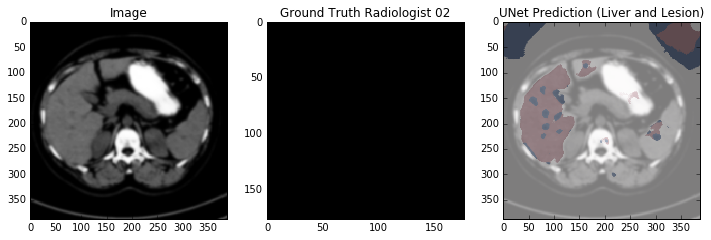

(388, 388)


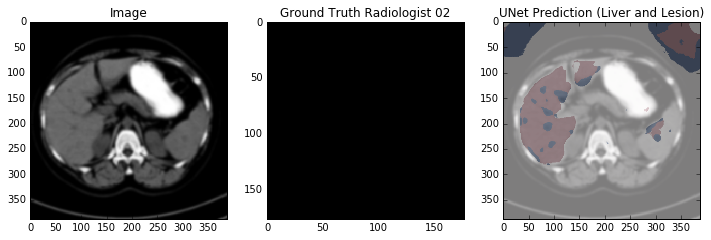

(388, 388)


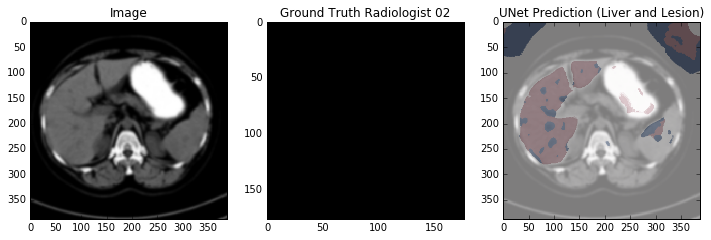

(388, 388)


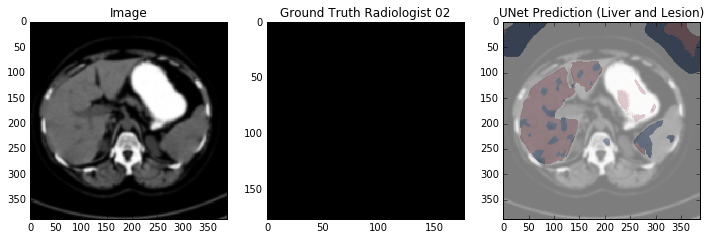

(388, 388)


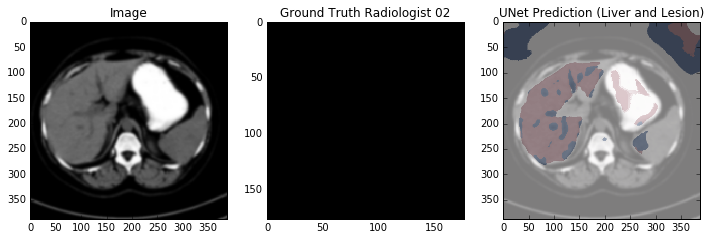

(388, 388)


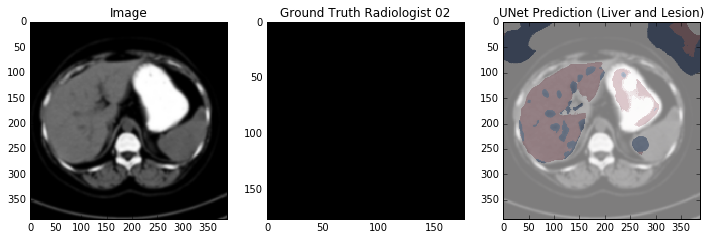

(388, 388)


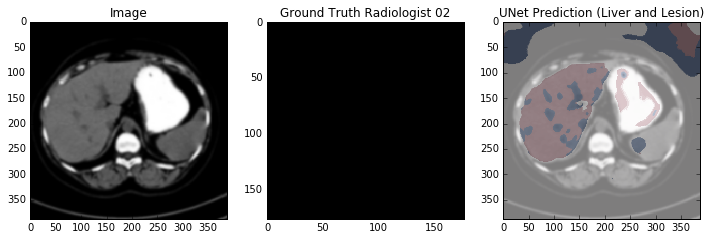

(388, 388)


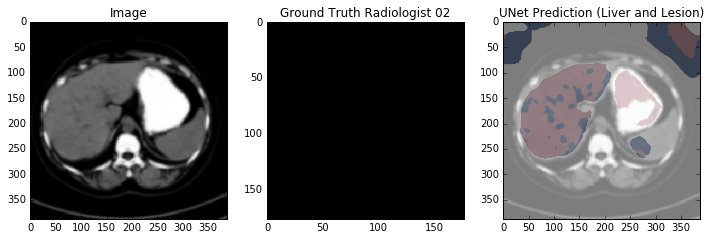

(388, 388)


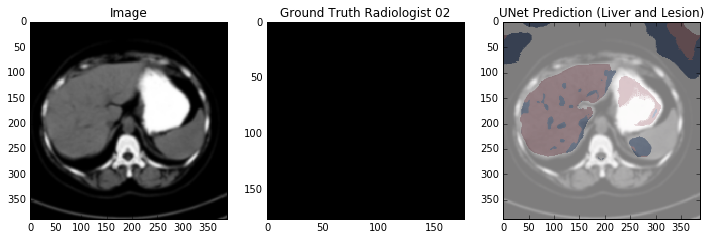

(388, 388)


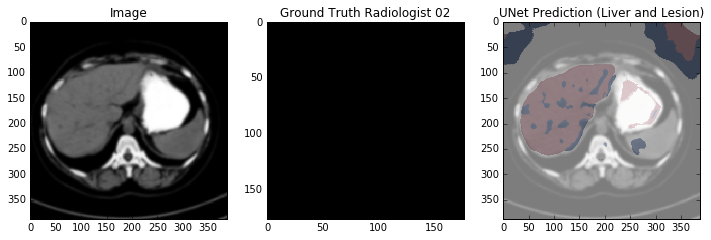

(388, 388)


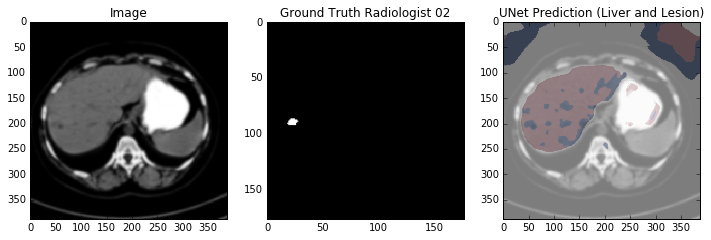

(388, 388)


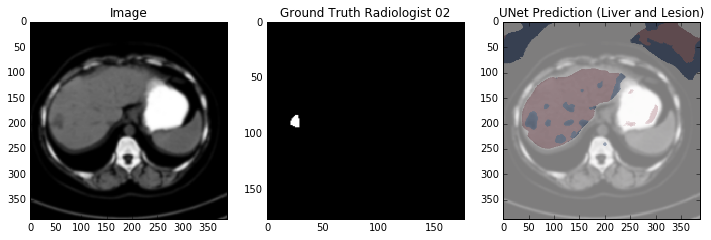

(388, 388)


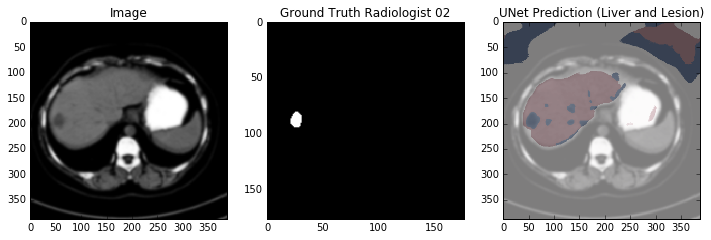

(388, 388)


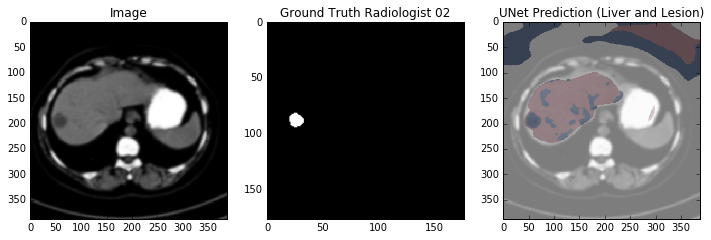

(388, 388)


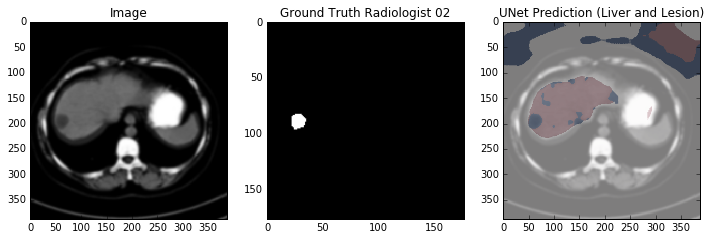

(388, 388)


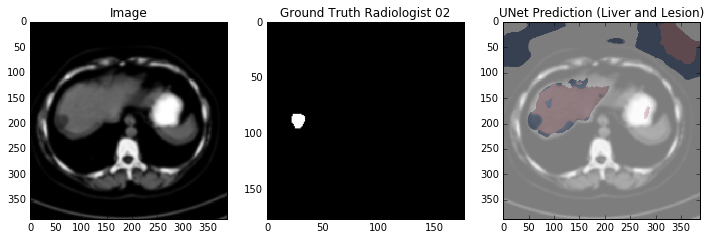

(388, 388)


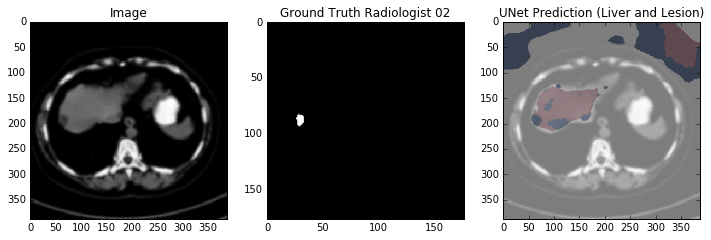

(388, 388)


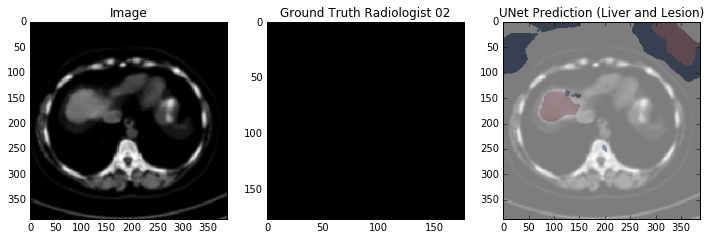

(388, 388)


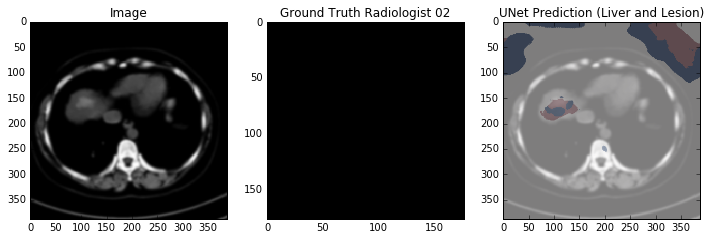

(388, 388)


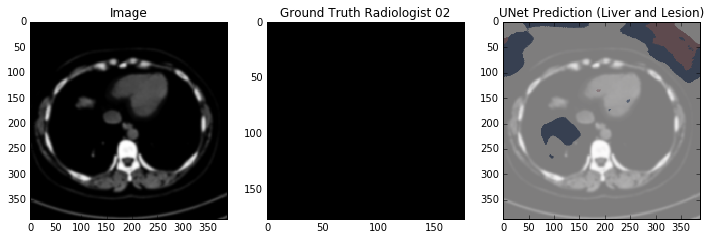

(388, 388)


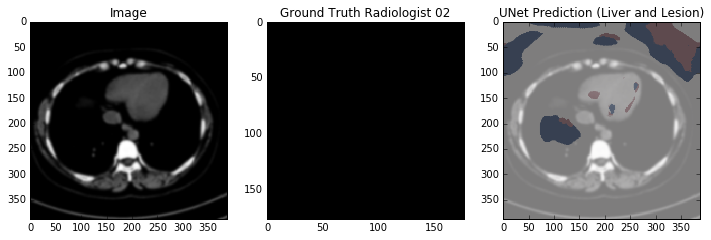

(388, 388)


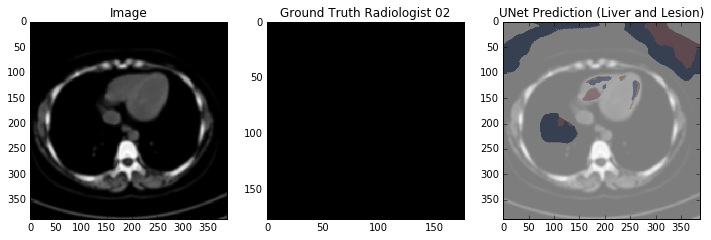

(388, 388)


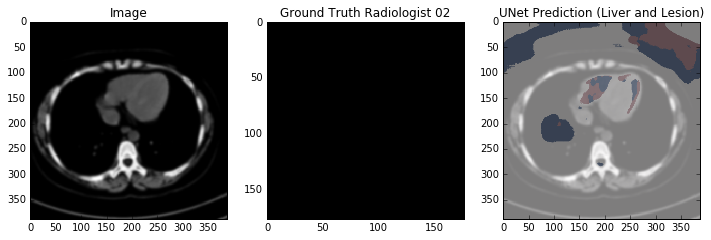

(388, 388)


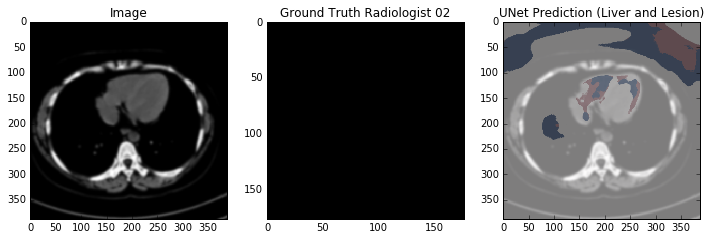

(388, 388)


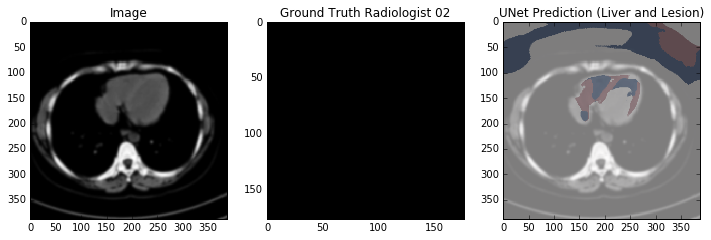

(388, 388)


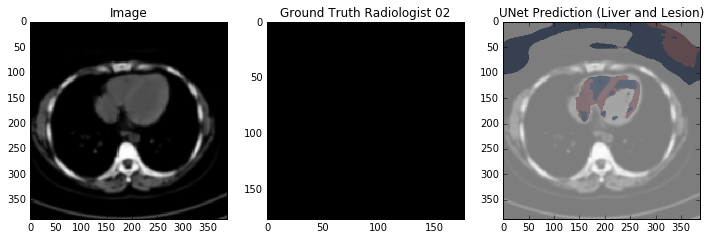

In [100]:
print d.shape
for idx in range(0,d.shape[2],2): 
    slice = np.transpose(d[:,:,idx],(1,0))
    label = np.transpose(labeld[:,:,idx],(1,0))
    slice = np.array(Image.fromarray(slice).resize((388,388))).astype(np.float64)
    slice = np.pad(slice,((92,92),(92,92)),mode='reflect')
    net1.blobs['data'].data[...] = slice
    prob=net1.forward()['prob'][0]
    pred = np.argmax(prob,axis=0)
    print pred.shape
    #imshow(slice[92:480,92:480], pred)
    
    plt.figure(figsize=(12,12))
    plt.subplot(1,3,1)
    plt.title("Image")
    plt.imshow(slice[92:480,92:480])
    
    plt.subplot(1,3,2)
    plt.title("Ground Truth Radiologist 02")
    plt.imshow(label)
    
    plt.subplot(1,3,3)
    plt.title("UNet Prediction (Liver and Lesion)")
    plt.imshow(slice[92:480,92:480]);plt.hold(True)
    plt.imshow(pred==1, cmap="Reds", alpha=0.3);plt.hold(True)
    plt.imshow(pred==2, cmap="Blues", alpha=0.3)
    plt.show()

# Now let's try the cascade approach with net1 and net2 #
# Liver: Red , Lesion:Blue#

In [20]:
def custom_preprocess_image(img, seg):
    """ Custom preprocessing of img,seg for UNET architecture:
    Crops the background and upsamples the found patch."""

    # Remove background !
    img = np.multiply(img,np.clip(seg,0,1))
    # get patch size
    col_maxes = np.max(seg, axis=0) # a row
    row_maxes = np.max(seg, axis=1)# a column

    nonzero_colmaxes = np.nonzero(col_maxes)[0]
    nonzero_rowmaxes = np.nonzero(row_maxes)[0]

    x1, x2 = nonzero_colmaxes[0], nonzero_colmaxes[-1]
    y1, y2 = nonzero_rowmaxes[0], nonzero_rowmaxes[-1]
    width = x2-x1
    height= y2-y1
    MIN_WIDTH = 60
    MIN_HEIGHT= 60
    x_pad = (MIN_WIDTH - width) / 2.0 if width < MIN_WIDTH else 0
    y_pad = (MIN_HEIGHT - height)/2.0 if height < MIN_HEIGHT else 0

    x1 = max(0, x1-x_pad)
    x2 = min(img.shape[1], x2+x_pad)
    y1 = max(0, y1-y_pad)
    y2 = min(img.shape[0], y2+y_pad)  

    img = Image.fromarray(img[y1:y2+1, x1:x2+1])
    seg = Image.fromarray(seg[y1:y2+1, x1:x2+1])

    img=np.array(img.resize((388,388)))
    seg=np.array(seg.resize((388,388), resample=PIL.Image.NEAREST))

    # All non-lesion is background
    seg[seg==1]=0
    #Lesion label becomes 1
    seg[seg==2]=1

    # Now do padding for UNET, which takes 572x572
    #seg=np.pad(seg,((92,92),(92,92)),mode='reflect')
    img=np.pad(img,((92,92),(92,92)),mode='reflect')
    return img.astype(np.float64), seg.astype(np.uint8), (x1,x2,y1,y2)

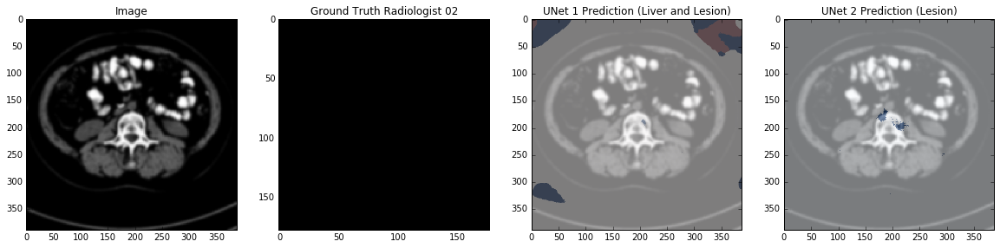

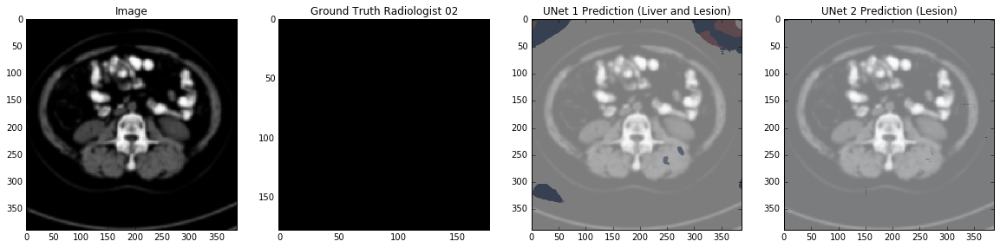

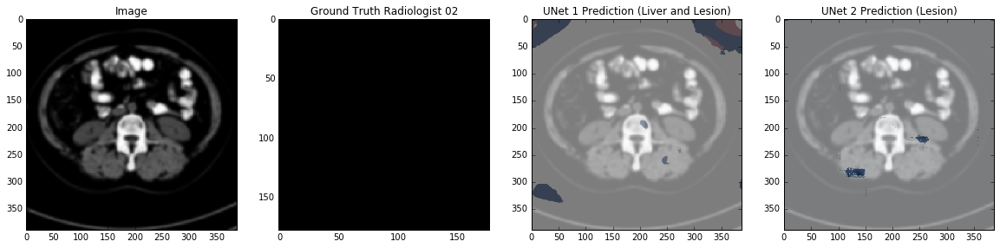

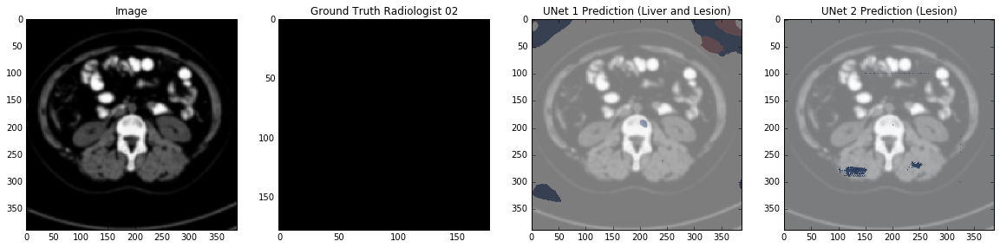

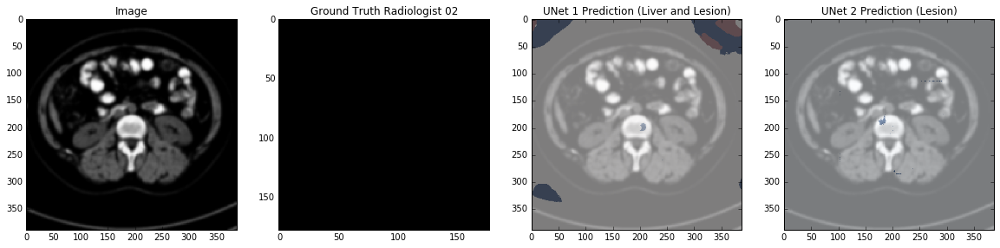

...

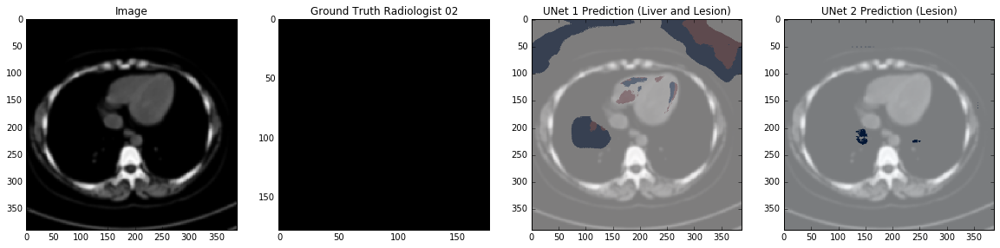

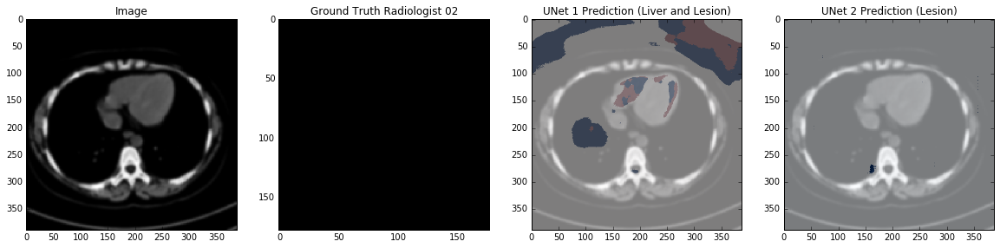

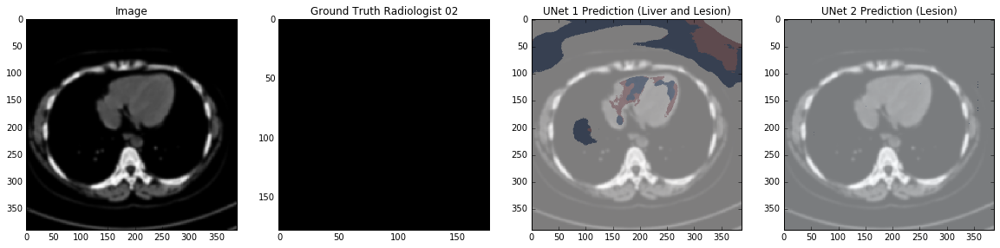

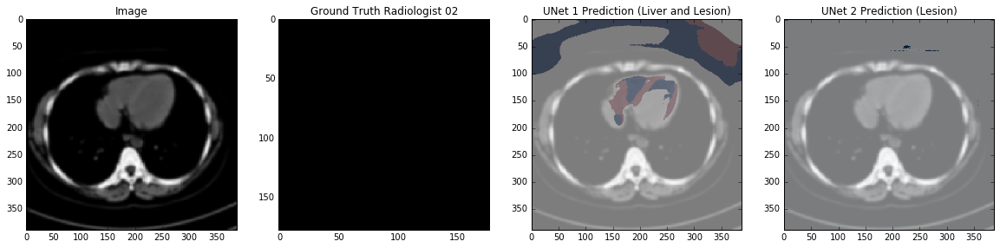

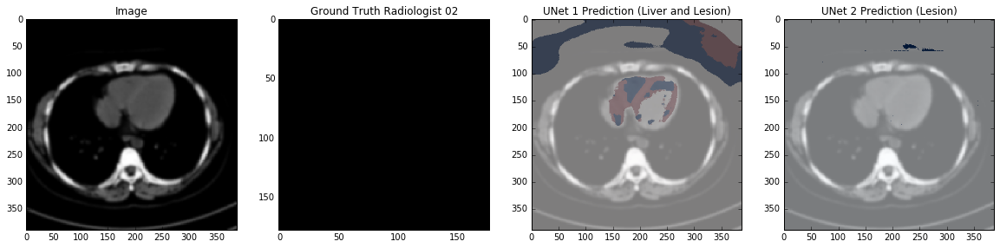

In [109]:
for idx in range(0,d.shape[2],2): 
    slice = np.transpose(d[:,:,idx],(1,0))
    label = np.transpose(labeld[:,:,idx],(1,0))
    slice388 = np.array(Image.fromarray(slice).resize((388,388))).astype(np.float64)
    # make slice 572 x 572
    slice = np.pad(slice388,((92,92),(92,92)),mode='reflect')
    orig_slice = np.copy(slice)
    net1.blobs['data'].data[...] = slice
    pred  = np.argmax(net1.forward()['prob'][0], axis=0)
    pred1 = np.copy(pred)
#    imshow(slice[92:480,92:480], pred1, title=['Original slice', 'UNet1 Prediction'])
    # Prepare for cascade
    slice,pred, box = custom_preprocess_image(slice[92:480,92:480],pred.astype(np.int8))

    #imshow(slice[92:480,92:480], pred, title=['Liver zoomed', 'prediction zoomed (not important)'])
    # NOW net2
    net2.blobs['data'].data[...] = slice
    pred=np.argmax(net2.forward()['prob'][0], axis=0).astype(np.int8)
    pred2 = np.copy(pred)
    #imshow(slice[92:480,92:480], pred2, title=['Liver zoomed','UNet2 prediction'])
    
    
    # Reconstruct prediction in original 388 image (unzoom)
    x1,x2,y1,y2 = box
    leftpad, rightpad = x1, 388-x2
    toppad, bottompad = y1, 388-y2
    width, height = x2-x1, y2-y1
    
    pred2=np.array(Image.fromarray(pred2).resize((width,height)))
    #imshow(pred,title=['unzoomed'])
    #print 'After unzooming',pred.shape
    #print 'box',y1,y2,x1,x2
    #print 'pad',pad
    #print 'toppad',toppad,'bottom',bottompad,'left',leftpad,'right',rightpad
    pred2 = np.pad(pred2, ((toppad,bottompad),(leftpad,rightpad)), mode='constant')
    #imshow(pred, title=['unzoomed AND padded'])
    #print 'Final shape',pred.shape
    
    plt.figure(figsize=(20,10))
    plt.subplot(1,4,1)
    plt.title("Image")
    plt.imshow(orig_slice[92:480,92:480])
    
    plt.subplot(1,4,2)
    plt.title("Ground Truth Radiologist 02")
    plt.imshow(label)
    
    plt.subplot(1,4,3)
    plt.title("UNet 1 Prediction (Liver and Lesion)")
    plt.imshow(orig_slice[92:480,92:480]);plt.hold(True)
    plt.imshow(pred1==1, cmap="Reds", alpha=0.3);plt.hold(True)
    plt.imshow(pred1==2, cmap="Blues", alpha=0.3)
    
    plt.subplot(1,4,4)
    plt.title("UNet 2 Prediction (Lesion)")
    plt.imshow(orig_slice[92:480,92:480]);plt.hold(True)
    plt.imshow(pred2, cmap="Blues", alpha=0.5)
    plt.show()
#    print '='*10,'\n','='*10,'\n','='*10


# . #
# . #
# . #
# . #
# Let's do the same for another volume ! #

In [112]:
d=nibabel.load("Patient02Homo.nii").get_data()
labeld=nibabel.load("Patient02Homo_Rad01.nii").get_data()

# 'plain' UNET on Volume 2 #

(180, 180, 258)
(388, 388)


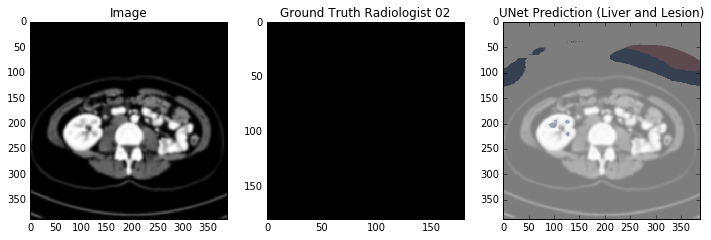

(388, 388)


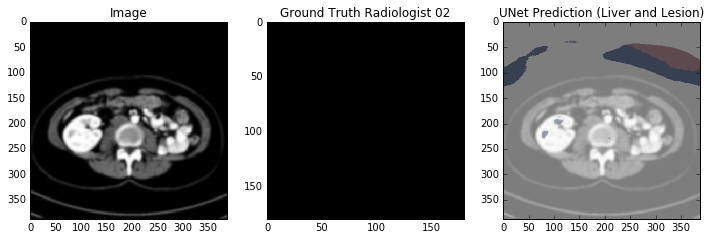

(388, 388)


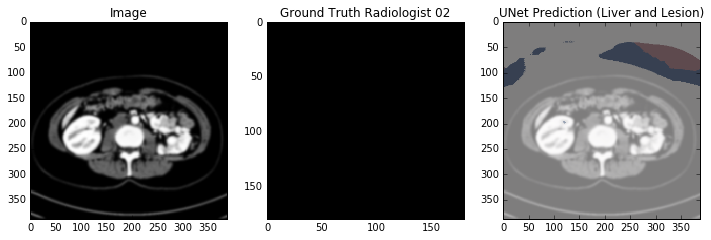

(388, 388)


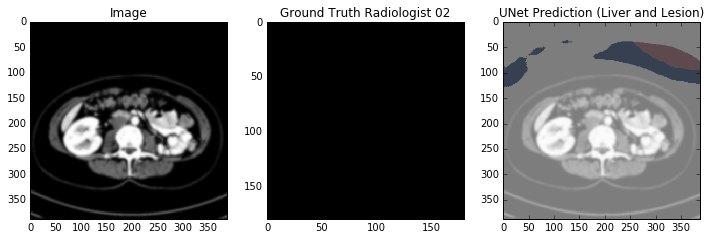

(388, 388)


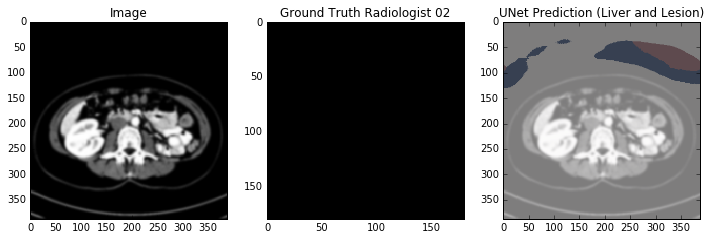

(388, 388)


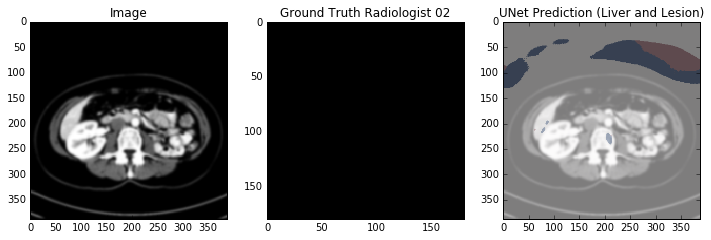

(388, 388)


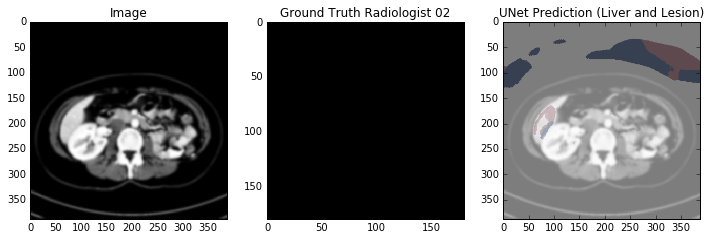

(388, 388)


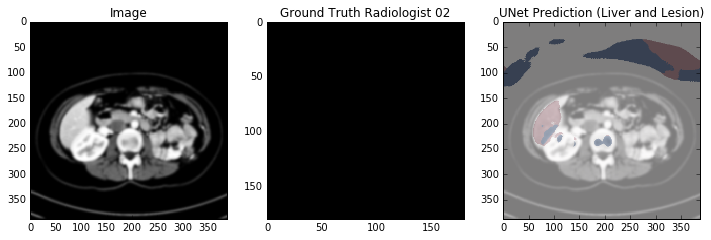

(388, 388)


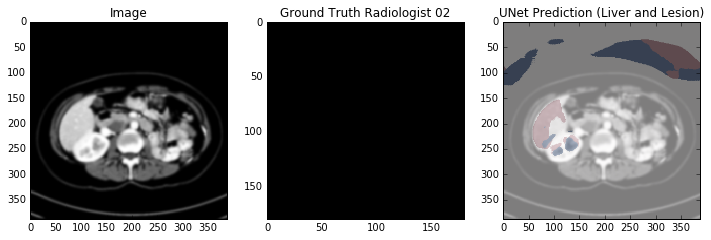

(388, 388)


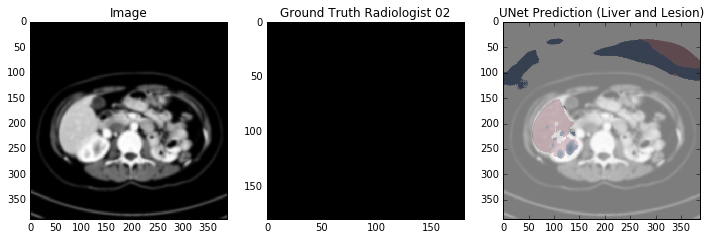

(388, 388)


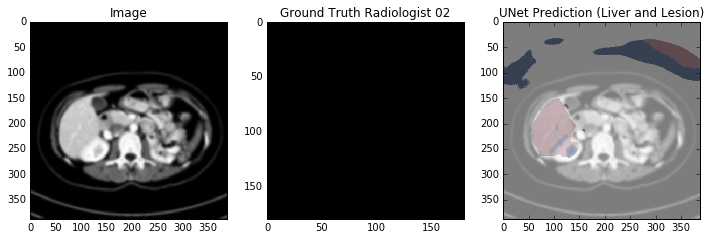

(388, 388)


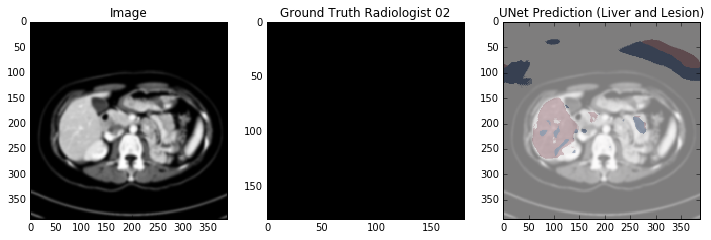

(388, 388)


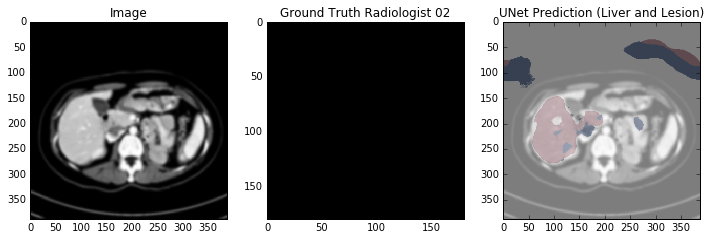

(388, 388)


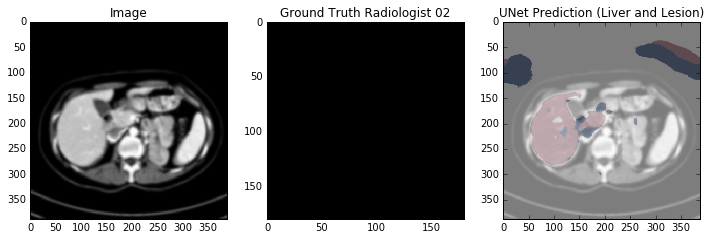

(388, 388)


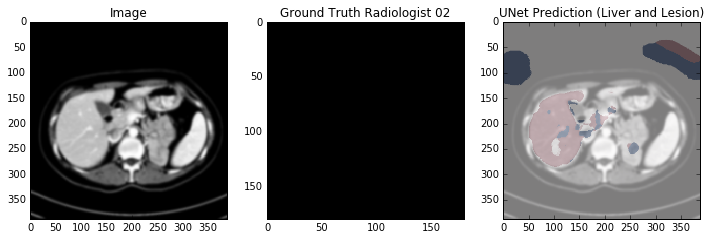

(388, 388)


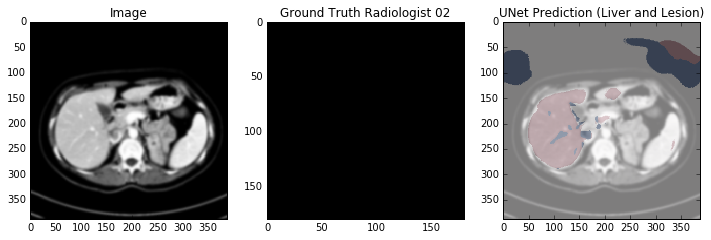

(388, 388)


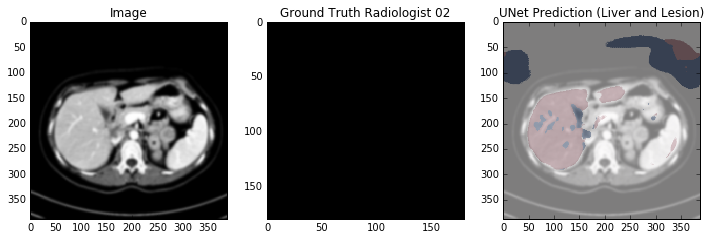

(388, 388)


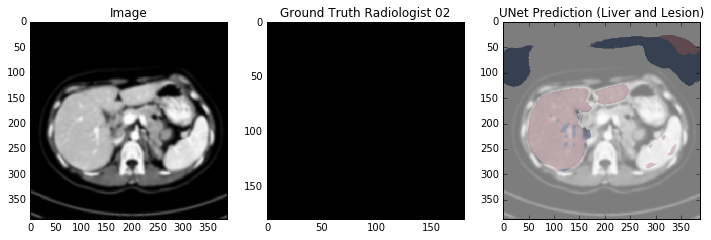

(388, 388)


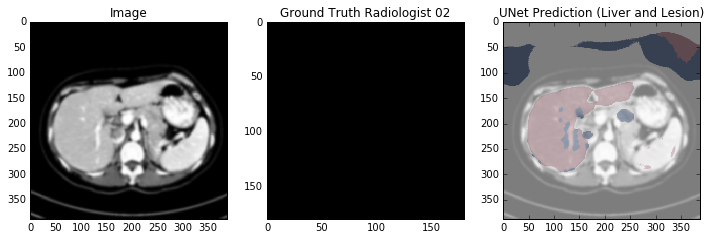

(388, 388)


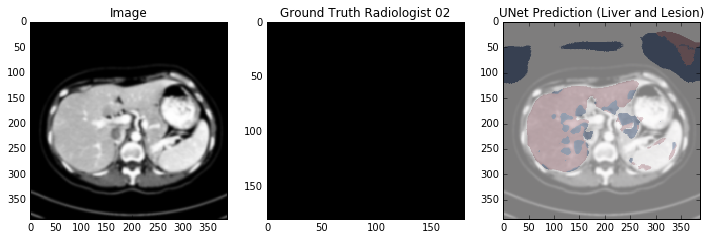

(388, 388)


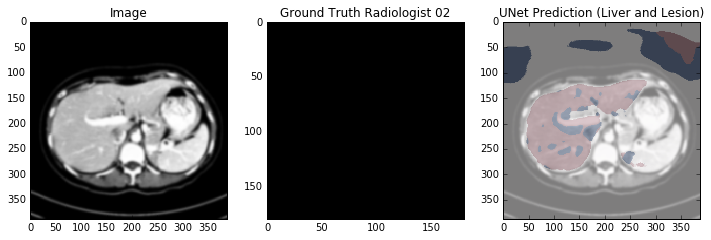

(388, 388)


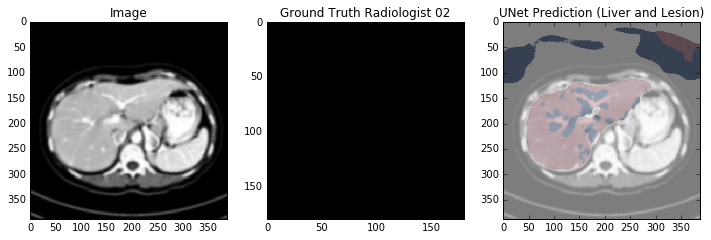

(388, 388)


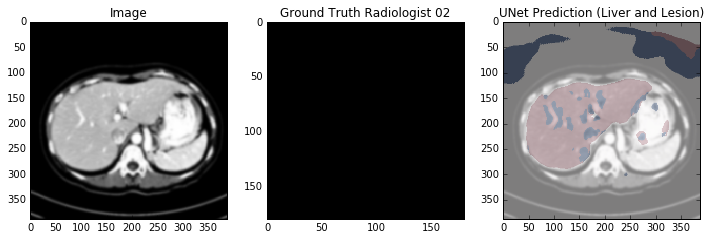

(388, 388)


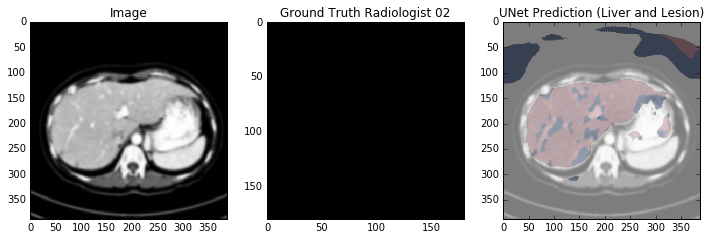

(388, 388)


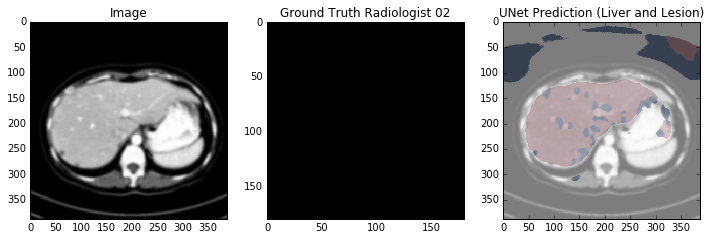

(388, 388)


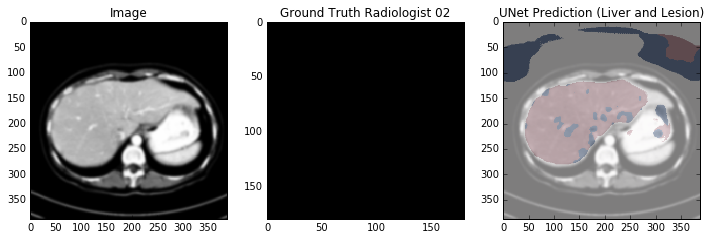

(388, 388)


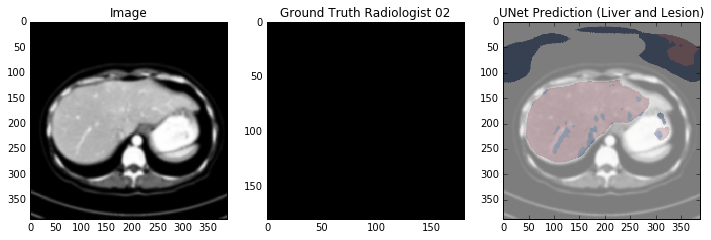

(388, 388)


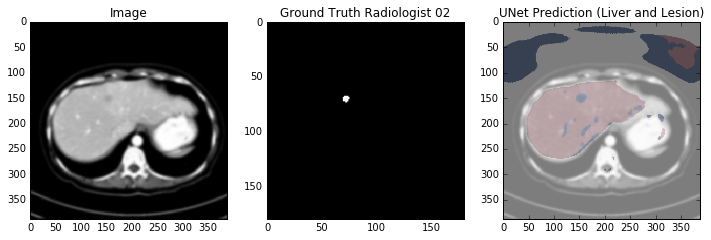

(388, 388)


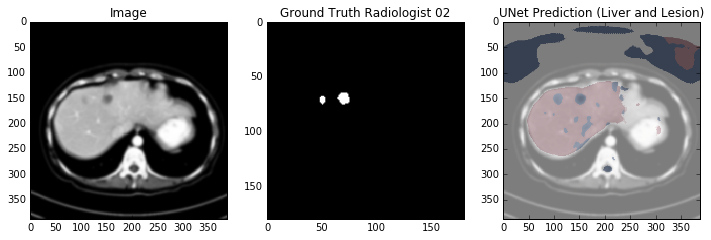

(388, 388)


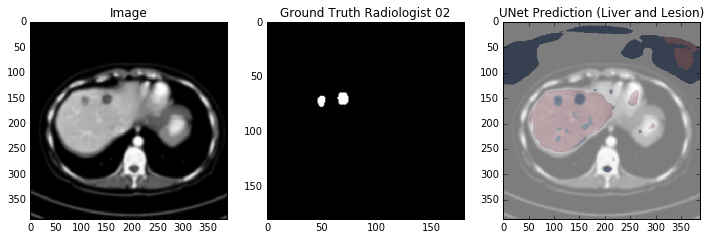

(388, 388)


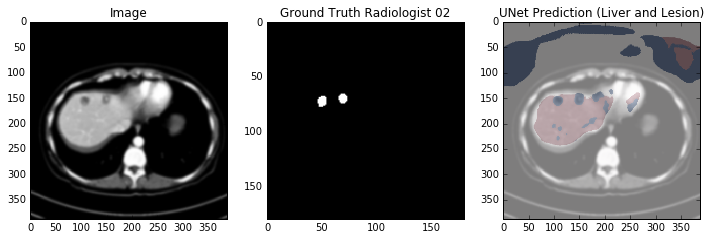

(388, 388)


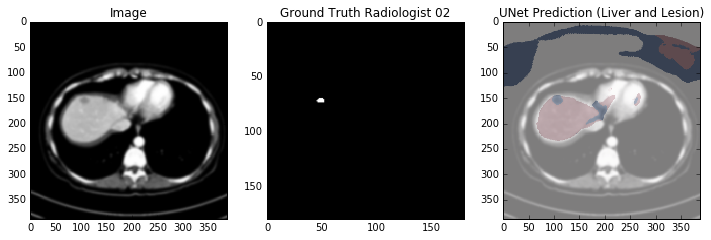

(388, 388)


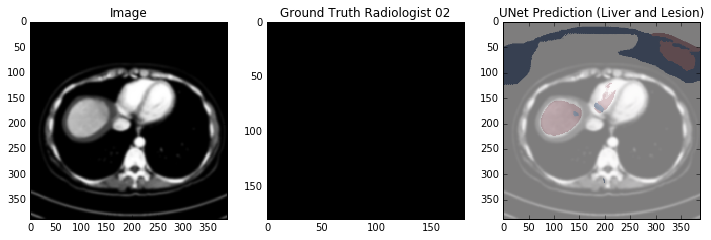

(388, 388)


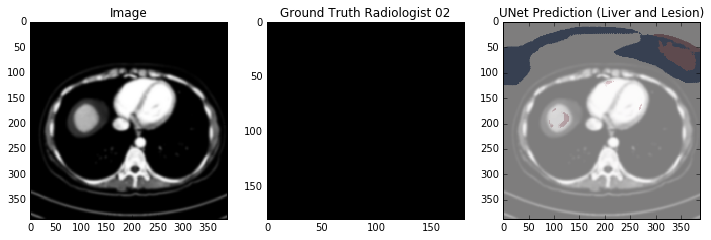

(388, 388)


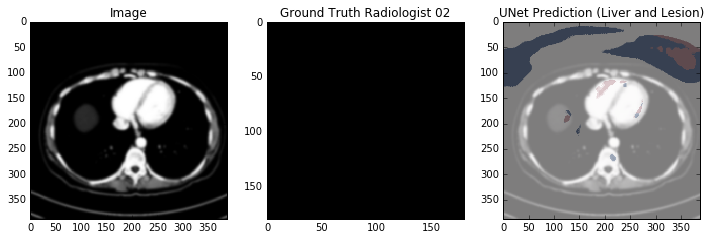

(388, 388)


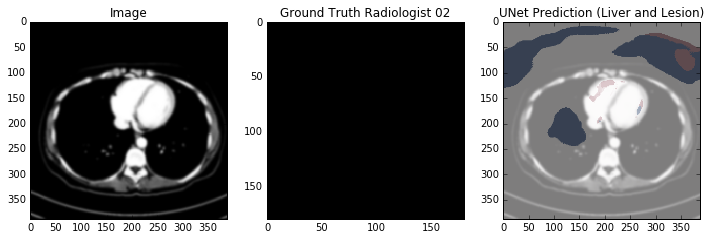

(388, 388)


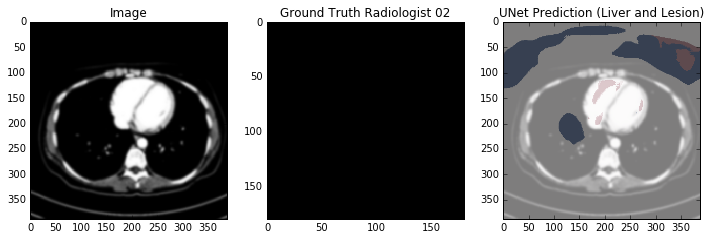

(388, 388)


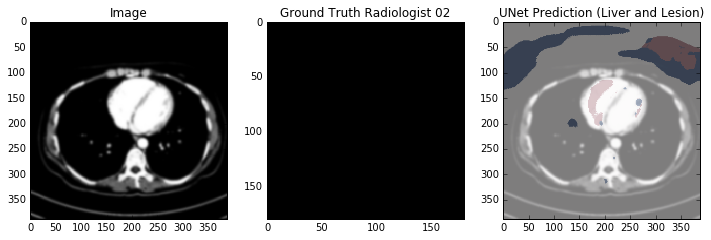

(388, 388)


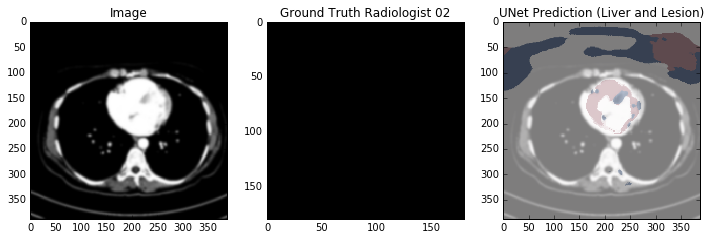

(388, 388)


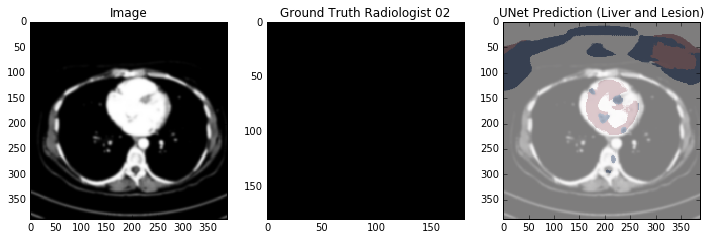

(388, 388)


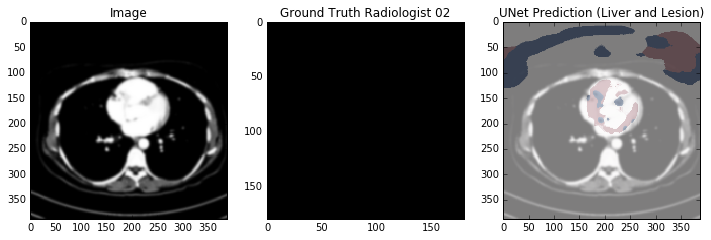

(388, 388)


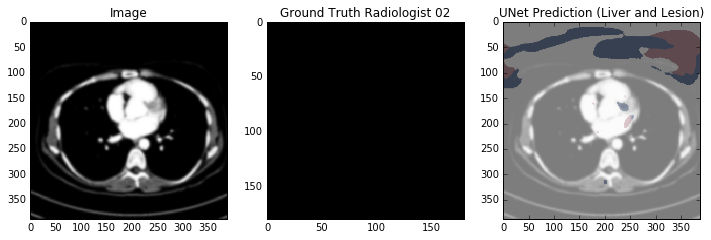

(388, 388)


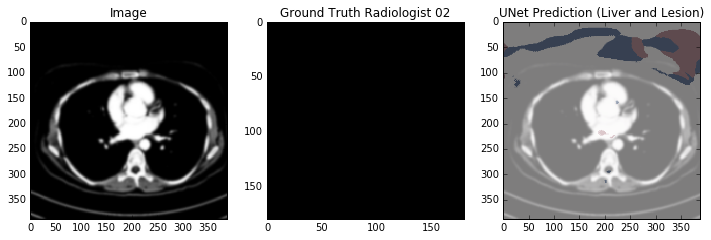

In [117]:
print d.shape
for idx in range(130,d.shape[2],3): 
    slice = np.transpose(d[:,:,idx],(1,0))
    label = np.transpose(labeld[:,:,idx],(1,0))
    slice = np.array(Image.fromarray(slice).resize((388,388))).astype(np.float64)
    slice = np.pad(slice,((92,92),(92,92)),mode='reflect')
    net1.blobs['data'].data[...] = slice
    prob=net1.forward()['prob'][0]
    pred = np.argmax(prob,axis=0)
    print pred.shape
    #imshow(slice[92:480,92:480], pred)
    
    plt.figure(figsize=(12,12))
    plt.subplot(1,3,1)
    plt.title("Image")
    plt.imshow(slice[92:480,92:480])
    
    plt.subplot(1,3,2)
    plt.title("Ground Truth Radiologist 02")
    plt.imshow(label)
    
    plt.subplot(1,3,3)
    plt.title("UNet Prediction (Liver and Lesion)")
    plt.imshow(slice[92:480,92:480]);plt.hold(True)
    plt.imshow(pred==1, cmap="Reds", alpha=0.3);plt.hold(True)
    plt.imshow(pred==2, cmap="Blues", alpha=0.3)
    plt.show()

# Cascade approach on Volume 2 #


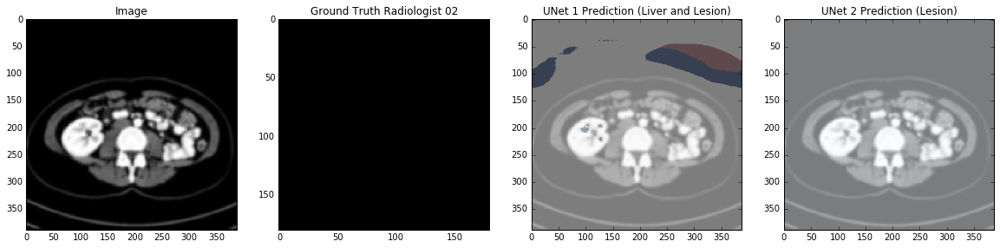

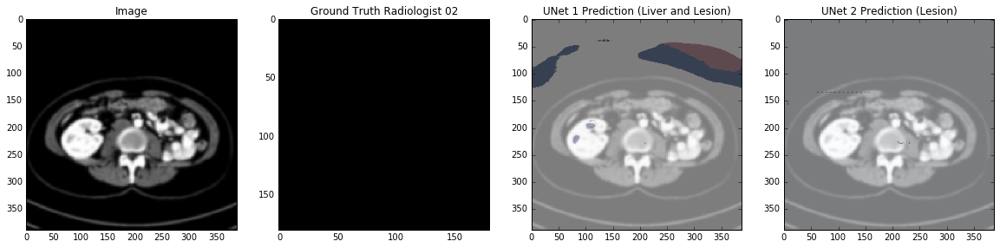

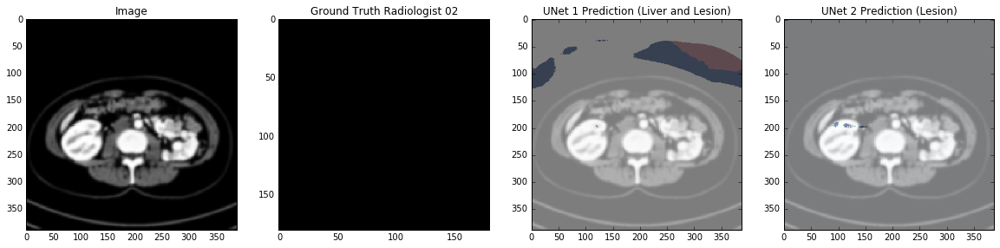

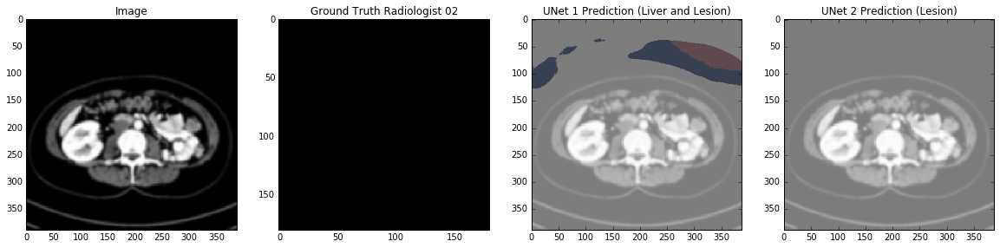

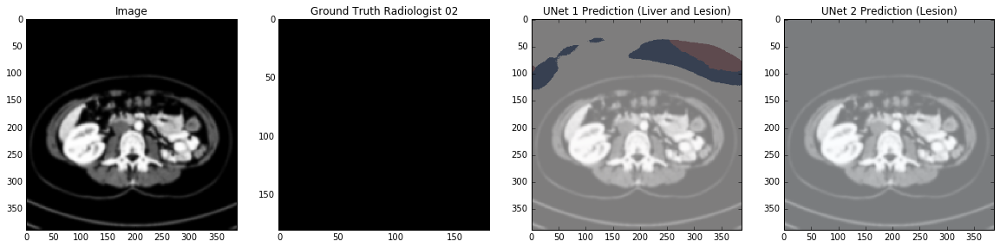

...

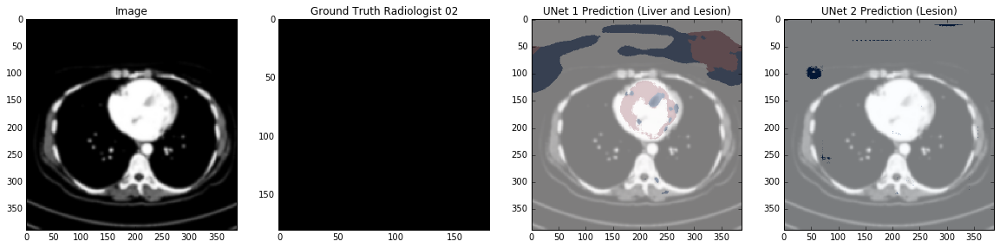

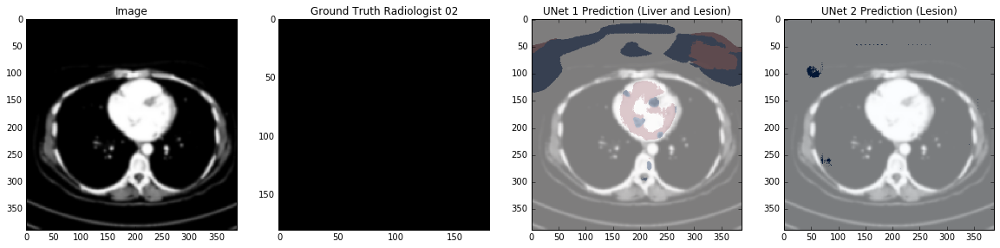

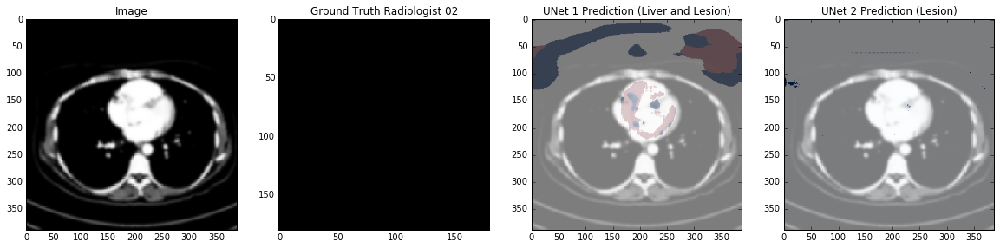

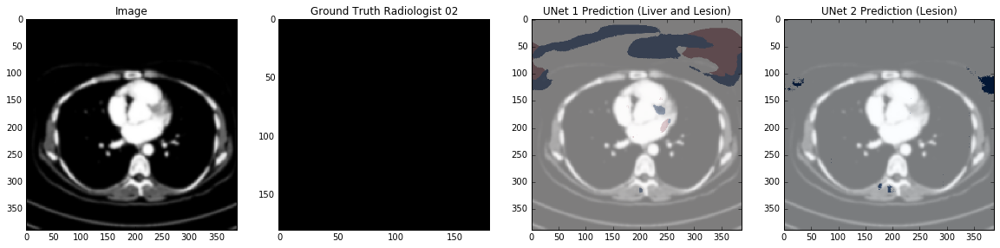

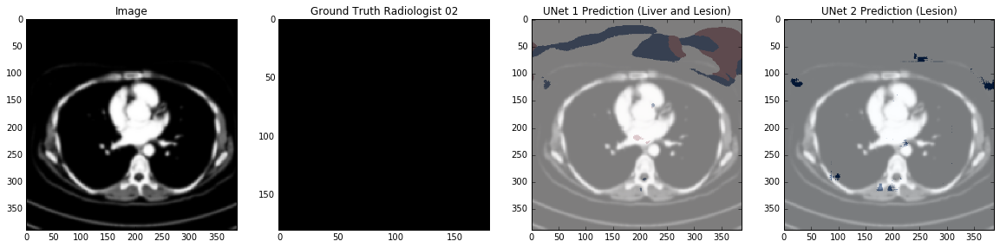

In [118]:
for idx in range(130,d.shape[2],3): 
    slice = np.transpose(d[:,:,idx],(1,0))
    label = np.transpose(labeld[:,:,idx],(1,0))
    slice388 = np.array(Image.fromarray(slice).resize((388,388))).astype(np.float64)
    # make slice 572 x 572
    slice = np.pad(slice388,((92,92),(92,92)),mode='reflect')
    orig_slice = np.copy(slice)
    net1.blobs['data'].data[...] = slice
    pred  = np.argmax(net1.forward()['prob'][0], axis=0)
    pred1 = np.copy(pred)
#    imshow(slice[92:480,92:480], pred1, title=['Original slice', 'UNet1 Prediction'])
    # Prepare for cascade
    slice,pred, box = custom_preprocess_image(slice[92:480,92:480],pred.astype(np.int8))

    #imshow(slice[92:480,92:480], pred, title=['Liver zoomed', 'prediction zoomed (not important)'])
    # NOW net2
    net2.blobs['data'].data[...] = slice
    pred=np.argmax(net2.forward()['prob'][0], axis=0).astype(np.int8)
    pred2 = np.copy(pred)
    #imshow(slice[92:480,92:480], pred2, title=['Liver zoomed','UNet2 prediction'])
    
    
    # Reconstruct prediction in original 388 image (unzoom)
    x1,x2,y1,y2 = box
    leftpad, rightpad = x1, 388-x2
    toppad, bottompad = y1, 388-y2
    width, height = x2-x1, y2-y1
    
    pred2=np.array(Image.fromarray(pred2).resize((width,height)))
    #imshow(pred,title=['unzoomed'])
    #print 'After unzooming',pred.shape
    #print 'box',y1,y2,x1,x2
    #print 'pad',pad
    #print 'toppad',toppad,'bottom',bottompad,'left',leftpad,'right',rightpad
    pred2 = np.pad(pred2, ((toppad,bottompad),(leftpad,rightpad)), mode='constant')
    #imshow(pred, title=['unzoomed AND padded'])
    #print 'Final shape',pred.shape
    
    plt.figure(figsize=(20,10))
    plt.subplot(1,4,1)
    plt.title("Image")
    plt.imshow(orig_slice[92:480,92:480])
    
    plt.subplot(1,4,2)
    plt.title("Ground Truth Radiologist 02")
    plt.imshow(label)
    
    plt.subplot(1,4,3)
    plt.title("UNet 1 Prediction (Liver and Lesion)")
    plt.imshow(orig_slice[92:480,92:480]);plt.hold(True)
    plt.imshow(pred1==1, cmap="Reds", alpha=0.3);plt.hold(True)
    plt.imshow(pred1==2, cmap="Blues", alpha=0.3)
    
    plt.subplot(1,4,4)
    plt.title("UNet 2 Prediction (Lesion)")
    plt.imshow(orig_slice[92:480,92:480]);plt.hold(True)
    plt.imshow(pred2, cmap="Blues", alpha=0.5)
    plt.show()
#    print '='*10,'\n','='*10,'\n','='*10
